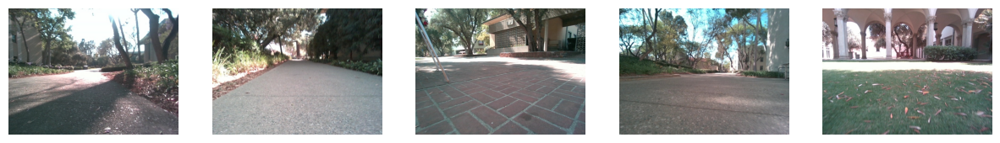

nb of images in the dataset:  74


In [1]:
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt


from src.tools import check_file_path
dataset_folder = 'datasets/dataset-2024-06-12_12-33-29'
cot_no_traversable = 2

valid_folder = check_file_path(dataset_folder, "valid")
valid_folder_manually = os.path.join(dataset_folder,'valid_manually_labelled')

imaege_folder = check_file_path(valid_folder,"rgb")
# Get a list of image files in the dataset folder
image_files = [check_file_path(imaege_folder, file) for file in os.listdir(imaege_folder) if file.endswith('.jpg')]
np.random.shuffle(image_files)
# Plot the first few images
num_images_to_plot = 5
fig, axes = plt.subplots(1, num_images_to_plot, figsize=(15, 3))

for i in range(num_images_to_plot):
    image = Image.open( image_files[i])
    axes[i].imshow(image)
    axes[i].axis('off')

plt.show()
print("nb of images in the dataset: ", len(image_files))


In [2]:
import os
from transformers import OneFormerProcessor, OneFormerForUniversalSegmentation
import torch
from src.tools import clear_folder
from src.tools import filename_to_timestamp
batch_size = 4
import shutil

# remove valid_folder_manually if it exists
if os.path.exists(valid_folder_manually):
      shutil.rmtree(valid_folder_manually)

# Define the folder paths

# clear_folder(valid_folder_manually)
valid_rgb_segmented_folder = os.path.join(valid_folder_manually,'rgb_segmented_color')
valid_masks_folder = os.path.join(valid_folder_manually,'rgb_segmented_label')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
class ImageDataset(torch.utils.data.Dataset):
  'Characterizes a dataset for PyTorch'
  def __init__(self, filename):
        'Initialization'
        self.filename = filename

  def __len__(self):
        'Denotes the total number of samples'
        return len(self.filename)

  def __getitem__(self, index):
        'Generates one sample of data'
        # Select sample
        image = Image.open(self.filename[index])
        timestamp = filename_to_timestamp(os.path.basename(self.filename[index]))
        return np.array(image), timestamp

processor = OneFormerProcessor.from_pretrained("shi-labs/oneformer_ade20k_swin_large")
model = OneFormerForUniversalSegmentation.from_pretrained("shi-labs/oneformer_ade20k_swin_large")
model = model.to(device)

image_set = ImageDataset(image_files)
dataloader = torch.utils.data.DataLoader(image_set, batch_size=batch_size, shuffle=False,num_workers=0, pin_memory=True)

id_to_label_name = {
  "0": "wall",
  "1": "building",
  "2": "sky",
  "3": "floor",
  "4": "tree",
  "5": "ceiling",
  "6": "road",
  "7": "bed ",
  "8": "windowpane",
  "9": "grass",
  "10": "cabinet",
  "11": "sidewalk",
  "12": "person",
  "13": "earth",
  "14": "door",
  "15": "table",
  "16": "mountain",
  "17": "plant",
  "18": "curtain",
  "19": "chair",
  "20": "car",
  "21": "water",
  "22": "painting",
  "23": "sofa",
  "24": "shelf",
  "25": "house",
  "26": "sea",
  "27": "mirror",
  "28": "rug",
  "29": "field",
  "30": "armchair",
  "31": "seat",
  "32": "fence",
  "33": "desk",
  "34": "rock",
  "35": "wardrobe",
  "36": "lamp",
  "37": "bathtub",
  "38": "railing",
  "39": "cushion",
  "40": "base",
  "41": "box",
  "42": "column",
  "43": "signboard",
  "44": "chest of drawers",
  "45": "counter",
  "46": "sand",
  "47": "sink",
  "48": "skyscraper",
  "49": "fireplace",
  "50": "refrigerator",
  "51": "grandstand",
  "52": "path",
  "53": "stairs",
  "54": "runway",
  "55": "case",
  "56": "pool table",
  "57": "pillow",
  "58": "screen door",
  "59": "stairway",
  "60": "river",
  "61": "bridge",
  "62": "bookcase",
  "63": "blind",
  "64": "coffee table",
  "65": "toilet",
  "66": "flower",
  "67": "book",
  "68": "hill",
  "69": "bench",
  "70": "countertop",
  "71": "stove",
  "72": "palm",
  "73": "kitchen island",
  "74": "computer",
  "75": "swivel chair",
  "76": "boat",
  "77": "bar",
  "78": "arcade machine",
  "79": "hovel",
  "80": "bus",
  "81": "towel",
  "82": "light",
  "83": "truck",
  "84": "tower",
  "85": "chandelier",
  "86": "awning",
  "87": "streetlight",
  "88": "booth",
  "89": "television receiver",
  "90": "airplane",
  "91": "dirt track",
  "92": "apparel",
  "93": "pole",
  "94": "land",
  "95": "bannister",
  "96": "escalator",
  "97": "ottoman",
  "98": "bottle",
  "99": "buffet",
  "100": "poster",
  "101": "stage",
  "102": "van",
  "103": "ship",
  "104": "fountain",
  "105": "conveyer belt",
  "106": "canopy",
  "107": "washer",
  "108": "plaything",
  "109": "swimming pool",
  "110": "stool",
  "111": "barrel",
  "112": "basket",
  "113": "waterfall",
  "114": "tent",
  "115": "bag",
  "116": "minibike",
  "117": "cradle",
  "118": "oven",
  "119": "ball",
  "120": "food",
  "121": "step",
  "122": "tank",
  "123": "trade name",
  "124": "microwave",
  "125": "pot",
  "126": "animal",
  "127": "bicycle",
  "128": "lake",
  "129": "dishwasher",
  "130": "screen",
  "131": "blanket",
  "132": "sculpture",
  "133": "hood",
  "134": "sconce",
  "135": "vase",
  "136": "traffic light",
  "137": "tray",
  "138": "ashcan",
  "139": "fan",
  "140": "pier",
  "141": "crt screen",
  "142": "plate",
  "143": "monitor",
  "144": "bulletin board",
  "145": "shower",
  "146": "radiator",
  "147": "glass",
  "148": "clock",
  "149": "flag"
}
# assign a color to each class
id_to_color={}
# set seed
np.random.seed(42)
for i in range(150):
    id_to_color[i] = np.hstack((np.random.rand(3),1))
print(id_to_color)

/home/gharib-ml/Desktop/master_thesis_v2/venv/lib/python3.8/site-packages/transformers/models/oneformer/image_processing_oneformer.py:446: FutureWarning: The `reduce_labels` argument is deprecated and will be removed in v4.27. Please use `do_reduce_labels` instead.
  warnings.warn(


{0: array([0.37454012, 0.95071431, 0.73199394, 1.        ]), 1: array([0.59865848, 0.15601864, 0.15599452, 1.        ]), 2: array([0.05808361, 0.86617615, 0.60111501, 1.        ]), 3: array([0.70807258, 0.02058449, 0.96990985, 1.        ]), 4: array([0.83244264, 0.21233911, 0.18182497, 1.        ]), 5: array([0.18340451, 0.30424224, 0.52475643, 1.        ]), 6: array([0.43194502, 0.29122914, 0.61185289, 1.        ]), 7: array([0.13949386, 0.29214465, 0.36636184, 1.        ]), 8: array([0.45606998, 0.78517596, 0.19967378, 1.        ]), 9: array([0.51423444, 0.59241457, 0.04645041, 1.        ]), 10: array([0.60754485, 0.17052412, 0.06505159, 1.        ]), 11: array([0.94888554, 0.96563203, 0.80839735, 1.        ]), 12: array([0.30461377, 0.09767211, 0.68423303, 1.        ]), 13: array([0.44015249, 0.12203823, 0.49517691, 1.        ]), 14: array([0.03438852, 0.9093204 , 0.25877998, 1.        ]), 15: array([0.66252228, 0.31171108, 0.52006802, 1.        ]), 16: array([0.54671028, 0.18485446

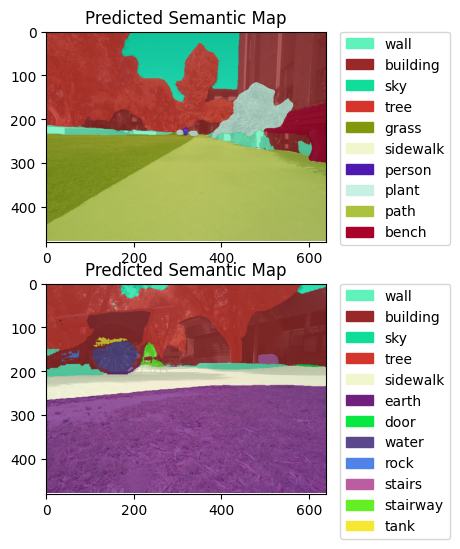

100%|██████████| 19/19 [00:33<00:00,  1.78s/it]


In [3]:
from tqdm import tqdm 
import matplotlib.patches as mpatches
from IPython.display import clear_output
%matplotlib inline
import time
def plot_predicted_semantic_map(input,image_label,ax):
    # Plot the predicted semantic map
    semantic_map_rgb = np.zeros((image_label.shape[0], image_label.shape[1], 3), dtype=np.uint8)
    unique_labels = np.unique(image_label)
    color=[id_to_color[label] for label in unique_labels]
    names=[id_to_label_name[str(label)] for label in unique_labels]
    patches = []
    for label_id,color,name in zip(unique_labels,color,names):
        semantic_map_rgb[image_label == label_id] = color[:3]*255
        patches.append(mpatches.Patch(color=color, label=name))
    ax.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )
    ax.imshow(input)
    ax.imshow(semantic_map_rgb,alpha=0.75)
    ax.set_title("Predicted Semantic Map")
    return semantic_map_rgb



# Create the folders if they don't exist
clear_folder(valid_rgb_segmented_folder)
clear_folder(valid_masks_folder)

with torch.inference_mode():
    for data in tqdm(dataloader):
        images,timestamps=data
        inputs = processor(images, ["semantic" for _ in range(len(images))], return_tensors="pt")          
        outputs = model(**inputs.to(device))
        
        predicted_semantic_map = processor.post_process_semantic_segmentation(
            outputs, target_sizes=[images[0].shape[0:2] for i in range(images.shape[0])]
        )
        clear_output(wait=True)
        image_size = len(images)
        fig, ax = plt.subplots(image_size, 1, figsize=(5, 3*image_size))
        for i in range(image_size):
            image_rgb = plot_predicted_semantic_map(images[i],predicted_semantic_map[i].cpu().numpy(),ax[i])
            # save image in valid_rgb_segmented_folder
            image = Image.fromarray(image_rgb)
            image.save(os.path.join(valid_rgb_segmented_folder, f"{timestamps[i]}.png"))
            np.save(os.path.join(valid_masks_folder, f"{timestamps[i]}.npy"), predicted_semantic_map[i].cpu().numpy())
        plt.show()
        # time.sleep(1)

    
        # break
        # for p in predicted_semantic_map:
        #     trav_color_rgb, trav_count = np.unique(np.array(p.cpu()).reshape(-1), axis=0,return_counts=True)
        #     results.append([trav_color_rgb, trav_count])

In [4]:
label_files = [check_file_path(valid_masks_folder, file) for file in os.listdir(valid_masks_folder) if file.endswith('.npy')]
total_counts = np.ones(150)*0.0001
id_label = []
cot_counts = np.zeros(150)

for label_file in label_files:
    # print(label_file)
    labels = np.load(label_file)
    # mask_path = check_file_path(dataset_folder,"mask",os.path.basename(label_file))
    # print(mask_path)
    masks = np.load(check_file_path(valid_folder,"mask",os.path.basename(label_file)))
    labels_id = np.unique(labels)
    id_label.extend(labels_id)
    for label_id in labels_id:
        cots = masks[labels == label_id]
        cots = cots[(cots > 0) & (cots < cot_no_traversable)]
        if cots.size == 0:
            continue
        cots_unique, count = np.unique(cots, return_counts=True)
        for cot, c in zip(cots_unique, count):
            cot_counts[label_id] += c*cot
            total_counts[label_id] += c
    # print(cot_counts)
    # print(masks)
    # print(labels.shape)
    # print()
    # print(np.unique(masks))
# print(total_counts)
id_label = np.unique(id_label)
# sort 
mean = cot_counts/total_counts
# print(mean[id_label])
for i in id_label:
    print(id_to_label_name[str(i)], mean[i], total_counts[i])


wall 1.3167979072886553 4616.0001
building 1.1284878658882531 1969.0001
sky 0.0 0.0001
floor 0.0 0.0001
tree 0.0 0.0001
road 0.9078726847877974 2742339.0001
grass 1.209787867090843 2463918.0001
cabinet 0.0 0.0001
sidewalk 0.9017592665317146 4144460.0001
person 0.8710885253092419 51.0001
earth 1.228076475922737 884112.0001000001
door 0.0 0.0001
table 0.0 0.0001
mountain 0.0 0.0001
plant 1.0102124731819053 858.0001
chair 0.0 0.0001
car 0.0 0.0001
water 0.0 0.0001
fence 0.0 0.0001
rock 0.9814630152689807 119.0001
railing 0.0 0.0001
base 0.0 0.0001
box 0.0 0.0001
column 1.3683919474825244 77.0001
signboard 0.0 0.0001
sand 0.9516247176323017 1.0001
path 0.9262704488824247 722766.0001000001
stairs 0.878991816783183 11.0001
stairway 0.0 0.0001
bridge 0.0 0.0001
bench 0.8853400225852186 151.0001
palm 0.0 0.0001
truck 0.0 0.0001
awning 0.0 0.0001
streetlight 0.0 0.0001
pole 0.0 0.0001
van 0.0 0.0001
bag 0.0 0.0001
ball 0.0 0.0001
step 0.0 0.0001
tank 0.0 0.0001
pot 0.0 0.0001
sculpture 0.0 0.00

[3, 6, 9, 11, 52]
timestamp: 1718143270.605823.npy
No traversable area detected 0.0
timestamp: 1716767354.036292.npy


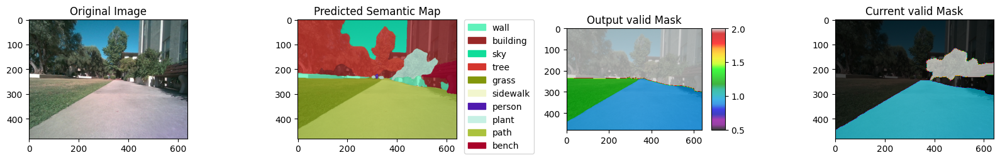

timestamp: 1718144323.764472.npy


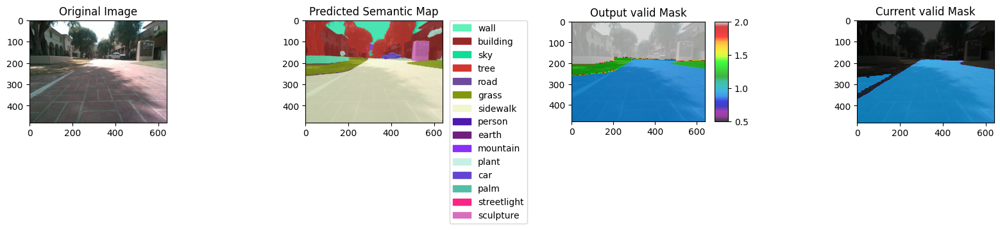

timestamp: 1716767346.132824.npy


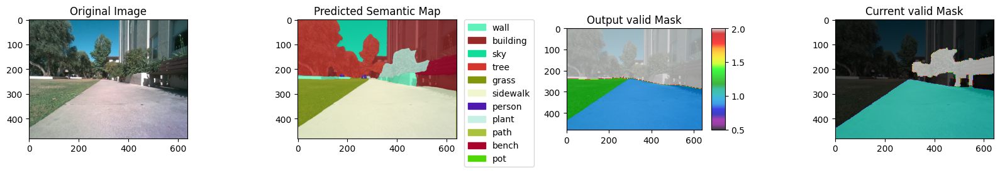

timestamp: 1716768187.640624.npy


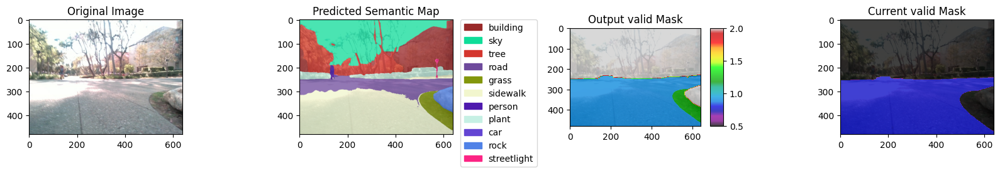

timestamp: 1716768596.963062.npy


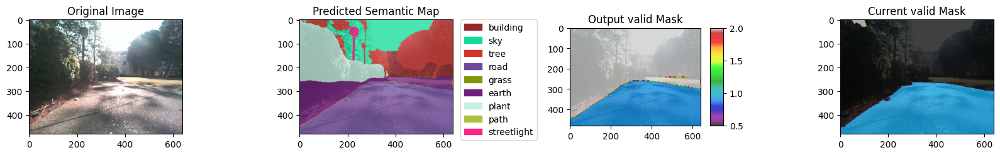

timestamp: 1716775919.269987.npy


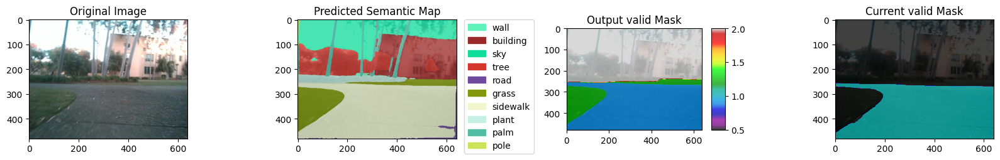

timestamp: 1718144142.857024.npy


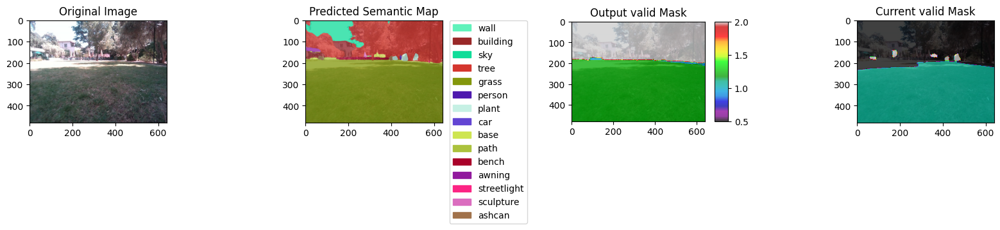

timestamp: 1718144342.998593.npy


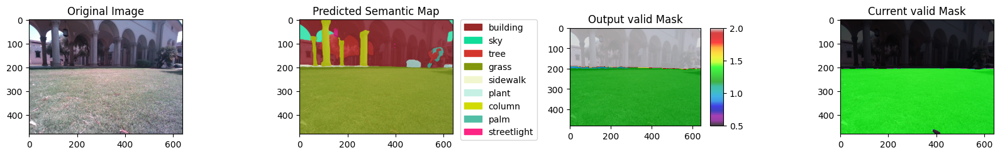

timestamp: 1716775929.077881.npy


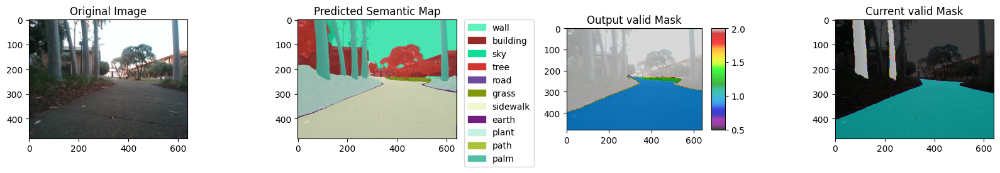

timestamp: 1718144266.079191.npy


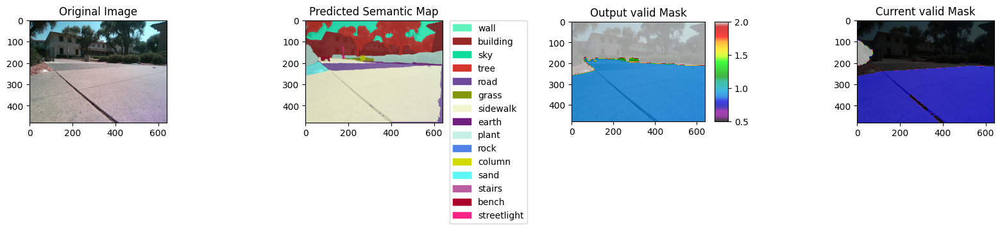

timestamp: 1716767200.369963.npy


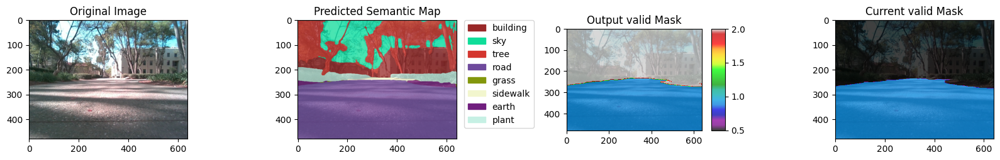

timestamp: 1716767366.473860.npy


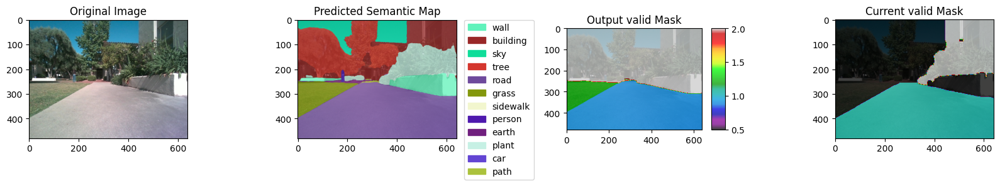

timestamp: 1716775908.708818.npy


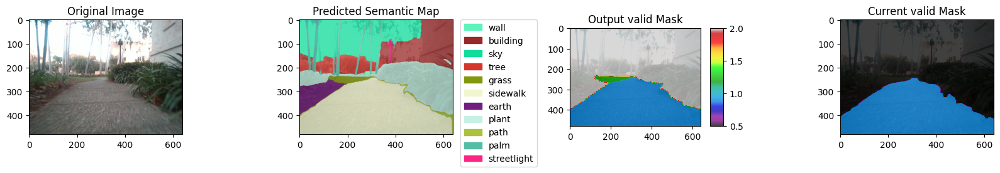

timestamp: 1718144313.350786.npy


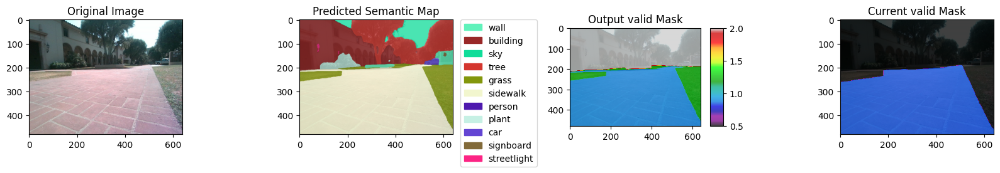

timestamp: 1718142776.869311.npy


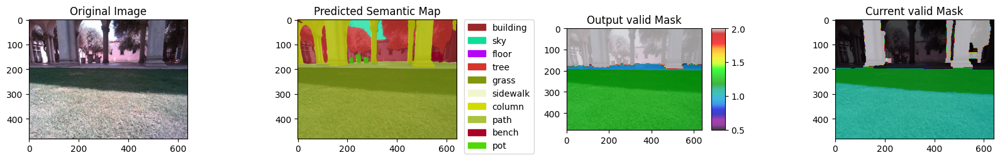

timestamp: 1718144430.515537.npy
No traversable area detected 0.023766276041666666
timestamp: 1716775933.611464.npy


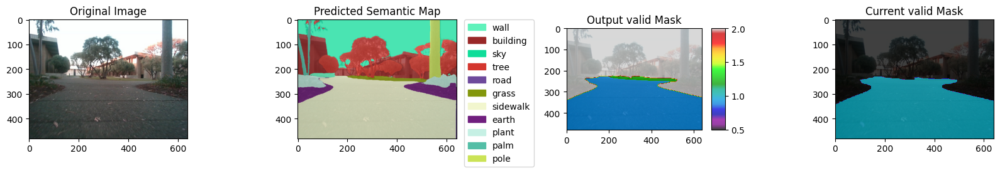

timestamp: 1718142686.564399.npy


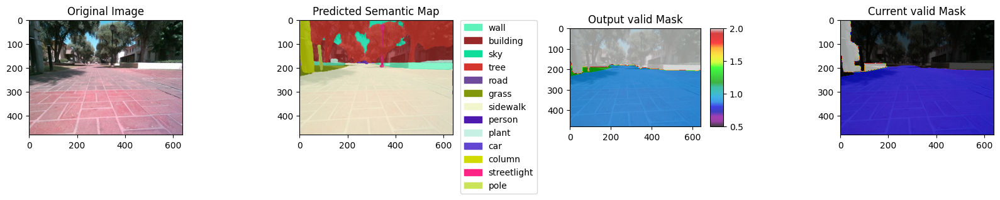

timestamp: 1718144171.276503.npy


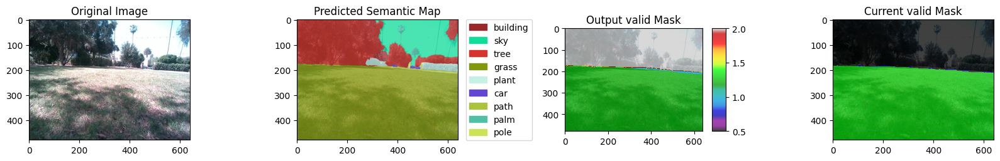

timestamp: 1718142724.675721.npy


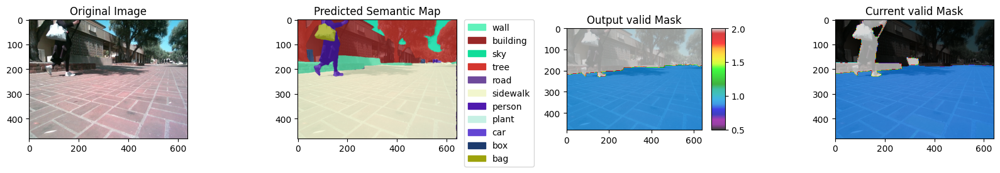

timestamp: 1718144165.251464.npy


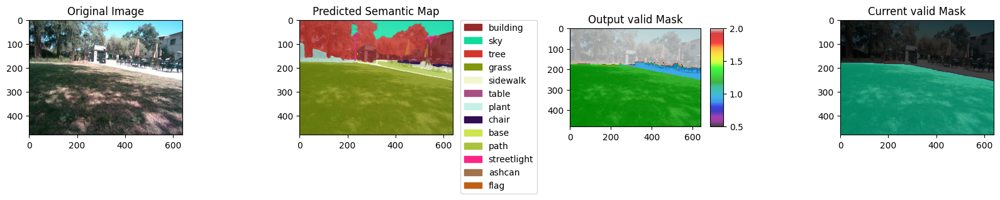

timestamp: 1718142743.217368.npy


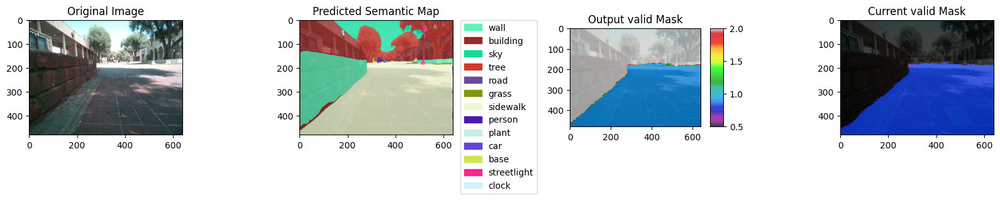

timestamp: 1718144252.255792.npy


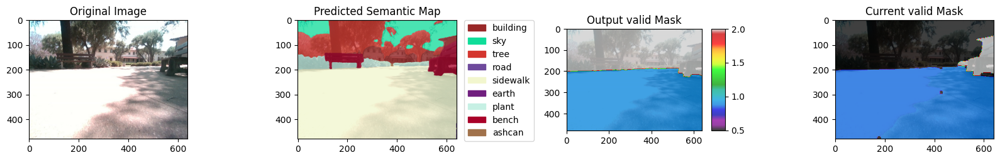

timestamp: 1716767370.276788.npy


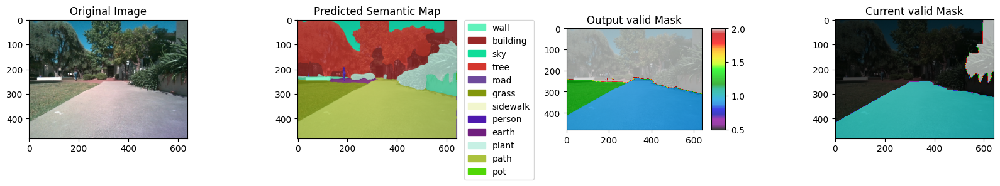

timestamp: 1718144349.169801.npy


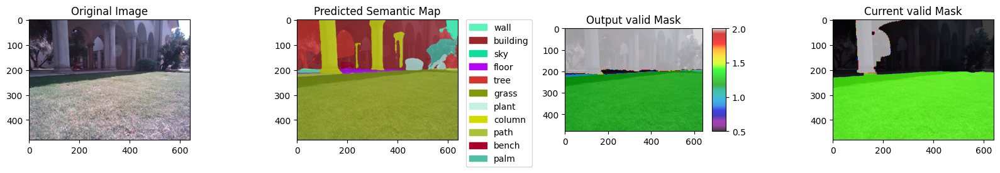

timestamp: 1716767251.625653.npy


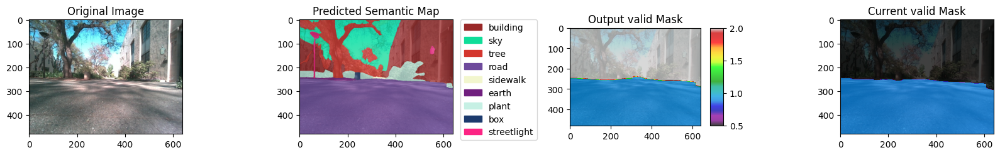

timestamp: 1716775924.540703.npy


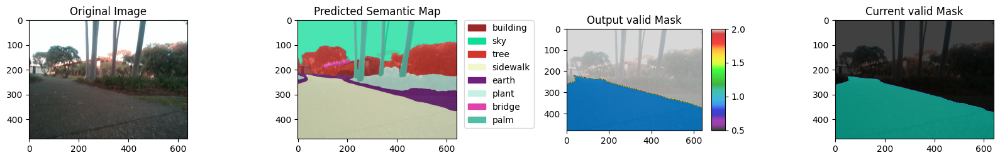

timestamp: 1712269482.664764.npy


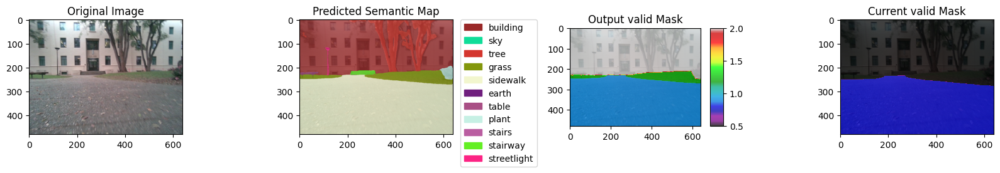

timestamp: 1718144263.535369.npy


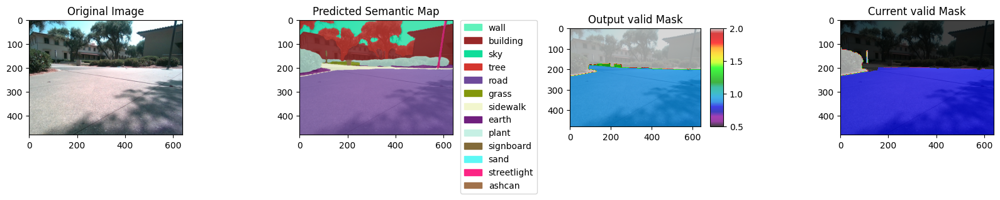

timestamp: 1718144227.803293.npy


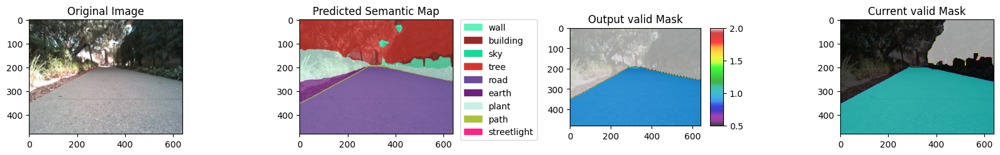

timestamp: 1718140746.886744.npy


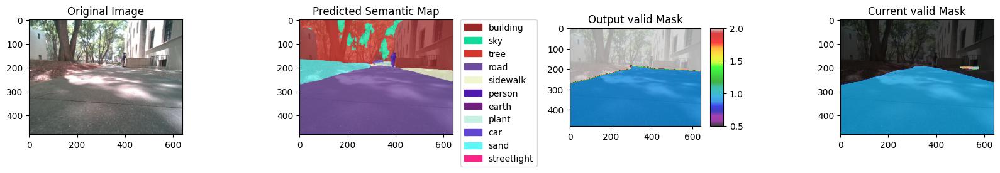

timestamp: 1712269502.698399.npy


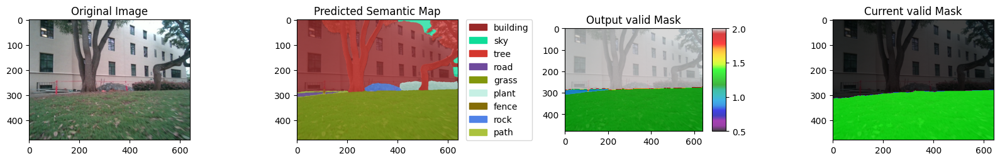

timestamp: 1716768211.116209.npy


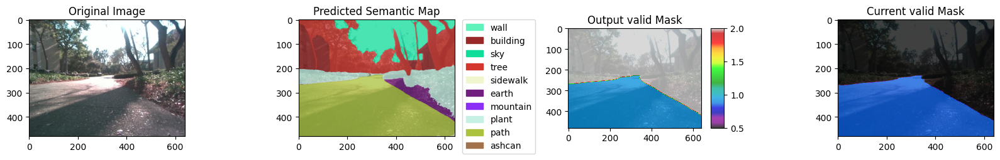

timestamp: 1718144424.903333.npy


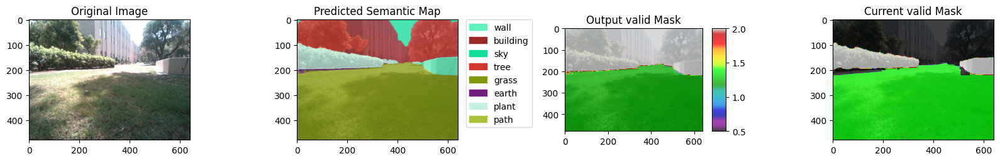

timestamp: 1716767188.799245.npy


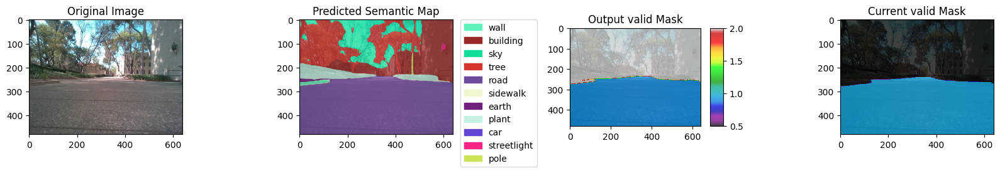

timestamp: 1716768246.399857.npy


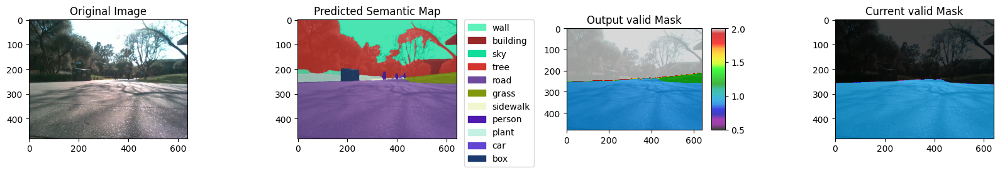

timestamp: 1716768390.697914.npy


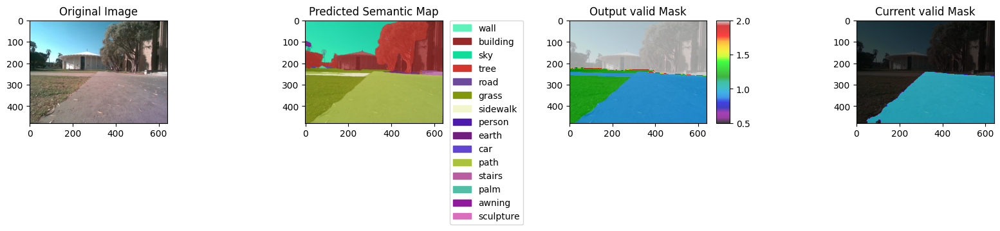

timestamp: 1718144163.921244.npy


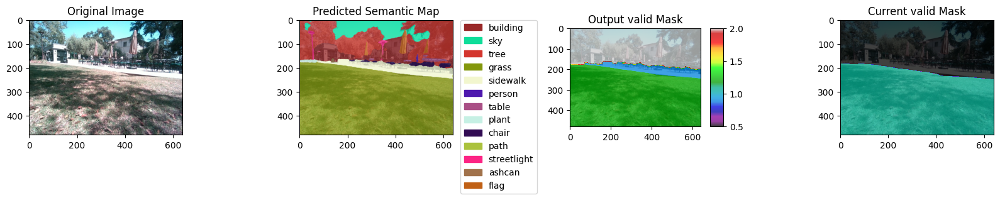

timestamp: 1716768200.346881.npy


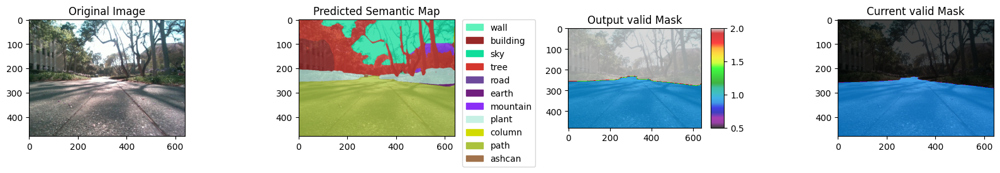

timestamp: 1716767209.906265.npy


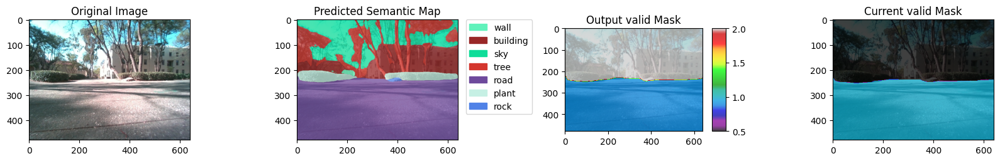

timestamp: 1712269402.725776.npy


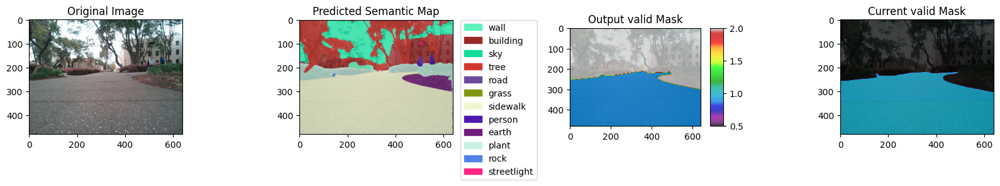

timestamp: 1718144431.615936.npy


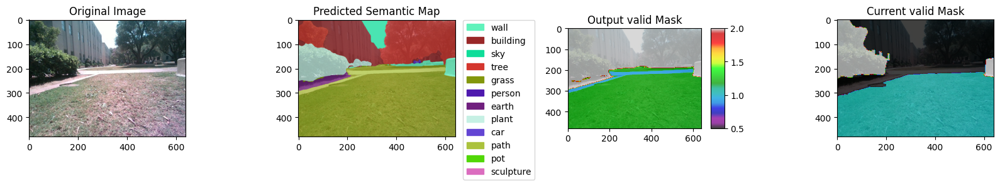

timestamp: 1718142770.999713.npy


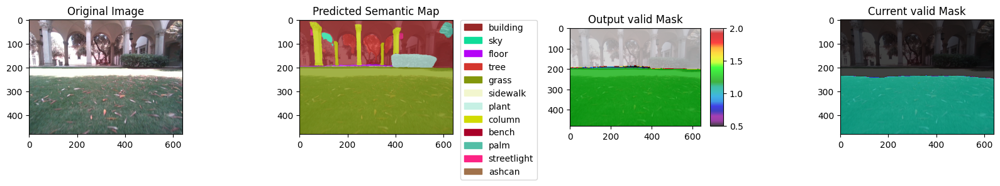

timestamp: 1716768222.326704.npy


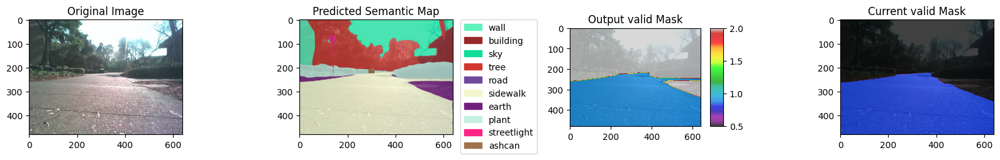

timestamp: 1718142738.851375.npy


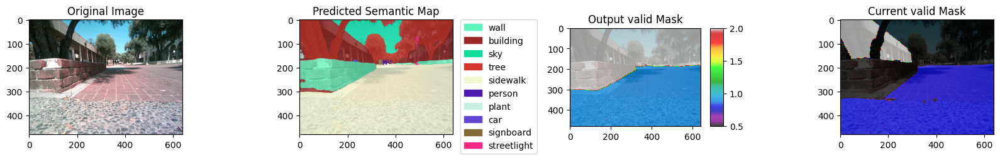

timestamp: 1716767290.441667.npy


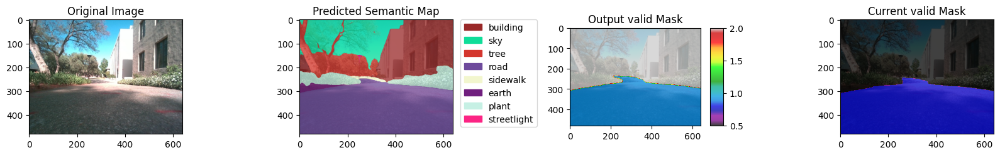

timestamp: 1718144260.943992.npy


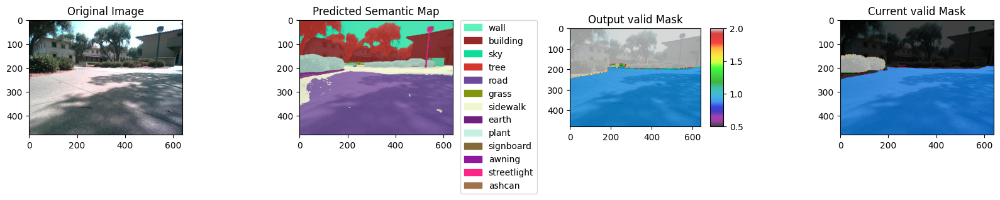

timestamp: 1718144310.818336.npy


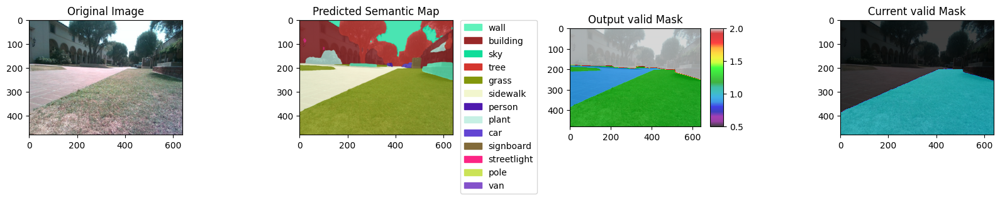

timestamp: 1718144378.381082.npy


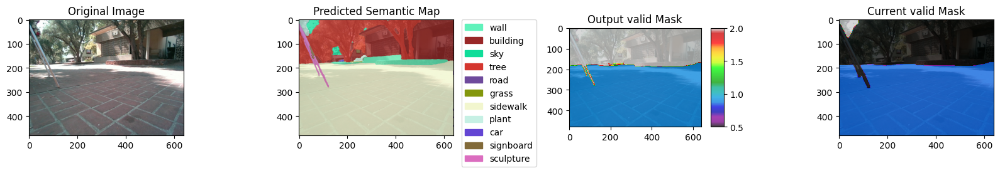

timestamp: 1718144229.135962.npy


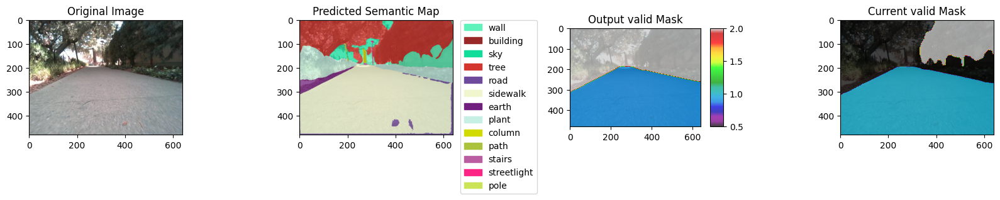

timestamp: 1718144223.824500.npy


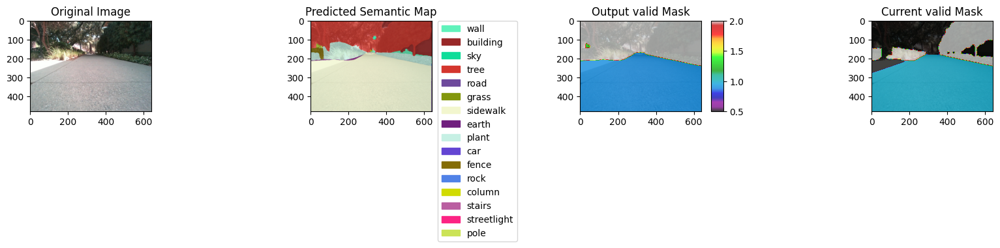

timestamp: 1718142733.148760.npy


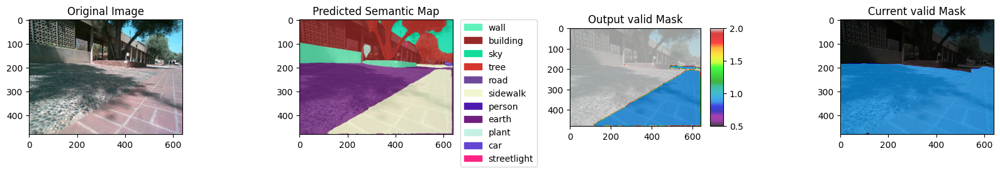

timestamp: 1718142740.217912.npy


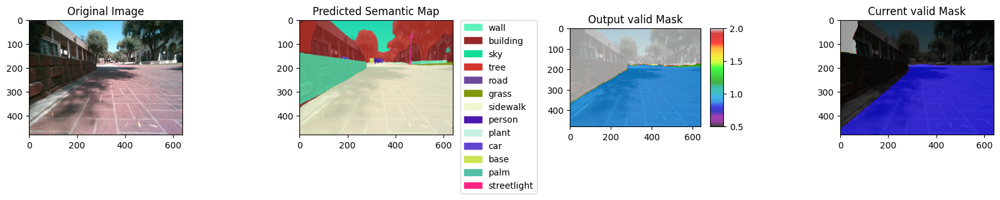

timestamp: 1716767264.662975.npy


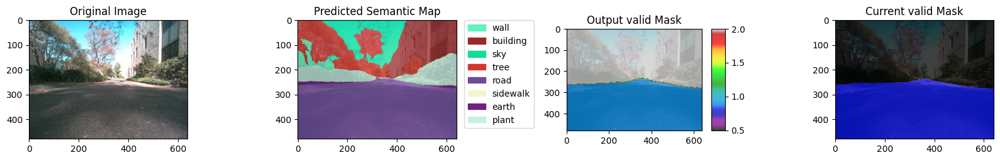

timestamp: 1718144393.227139.npy


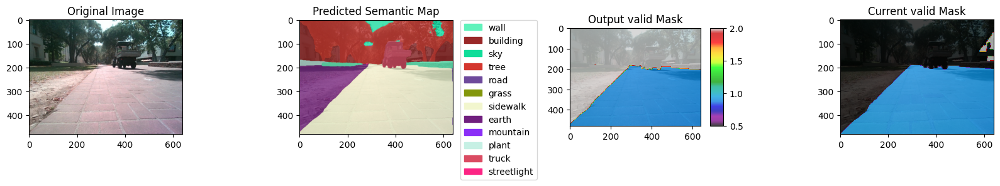

timestamp: 1718144372.805265.npy


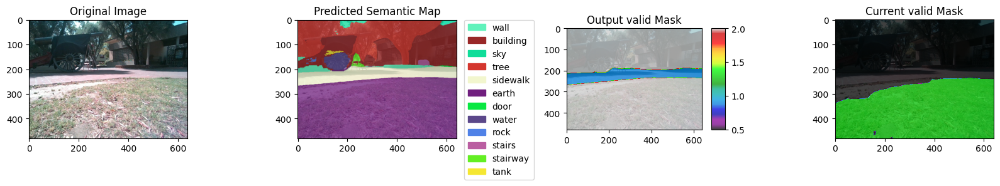

timestamp: 1716767186.295889.npy


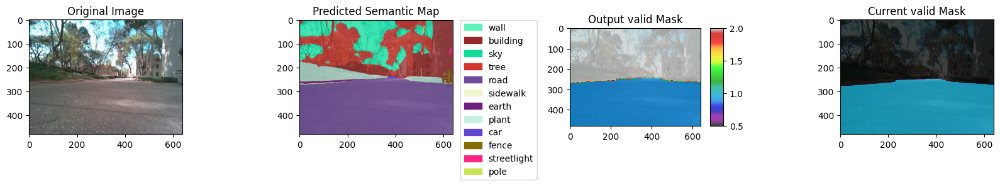

timestamp: 1718144364.115065.npy


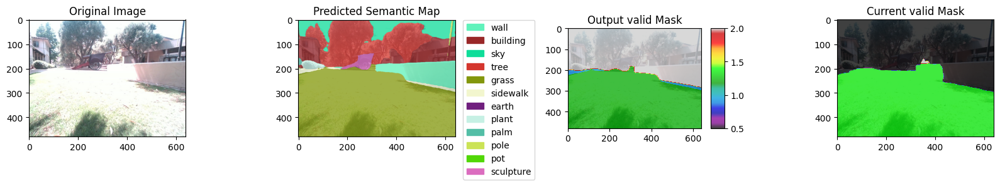

timestamp: 1718142731.814675.npy


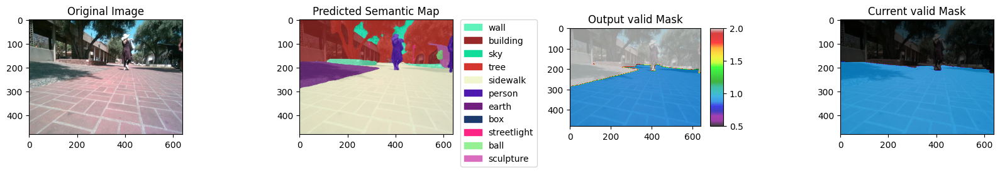

timestamp: 1716767329.260214.npy


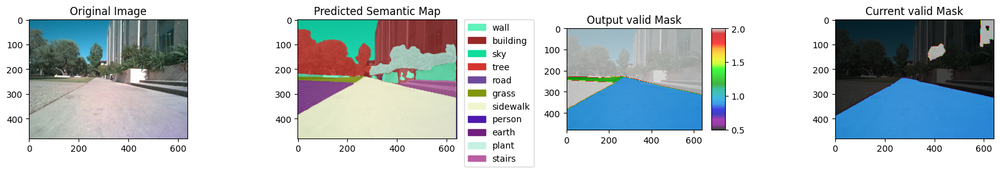

timestamp: 1716768193.878056.npy


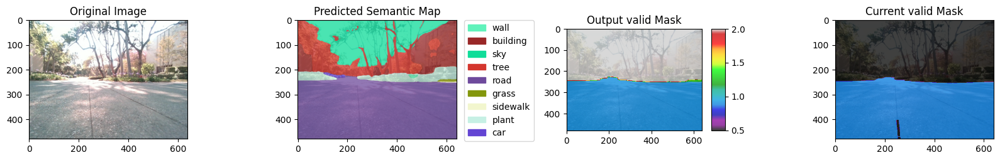

timestamp: 1718144183.683737.npy


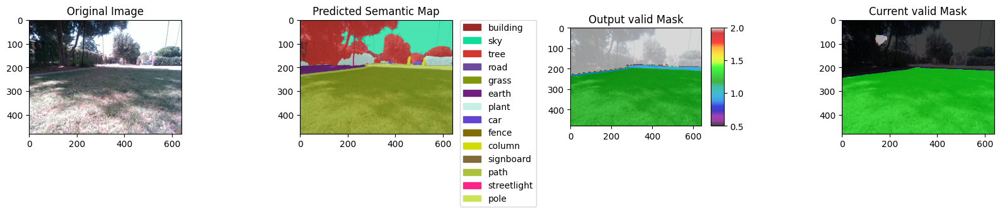

timestamp: 1718144213.387125.npy


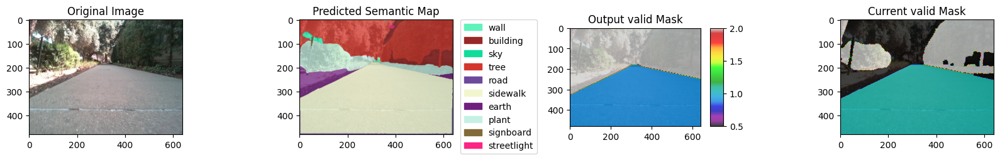

timestamp: 1718144438.110623.npy


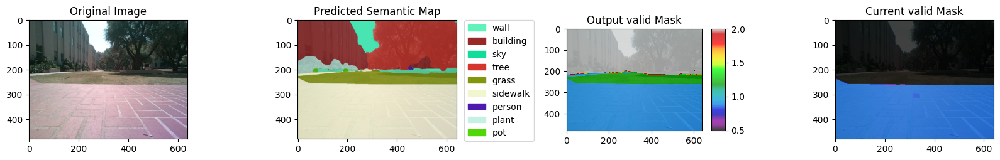

timestamp: 1716767211.339862.npy


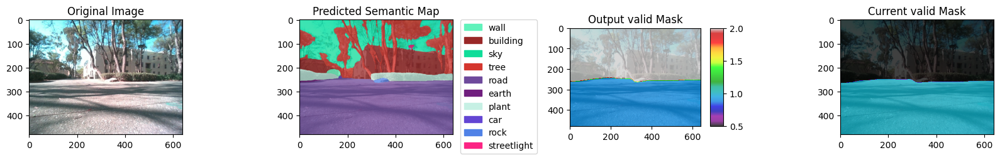

timestamp: 1718141227.442135.npy


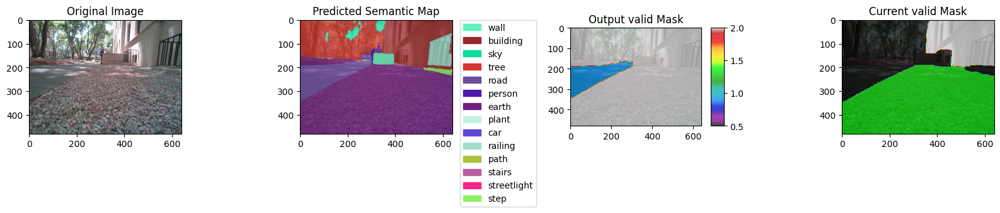

timestamp: 1718142292.329261.npy
No traversable area detected 0.0266015625
timestamp: 1712269407.226665.npy


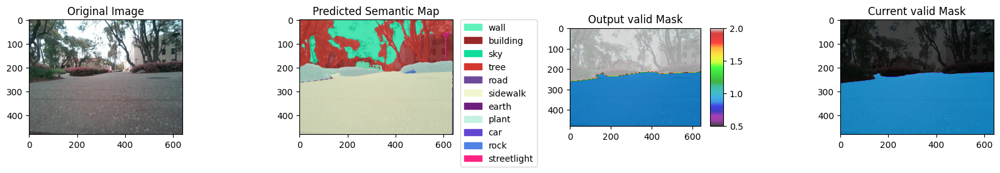

timestamp: 1716767293.076759.npy


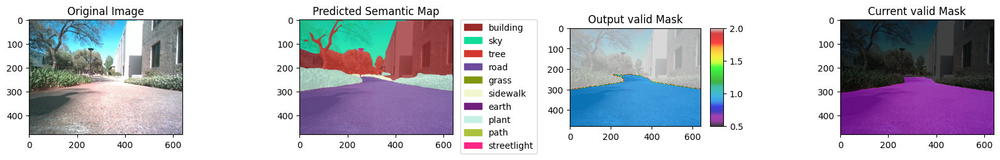

timestamp: 1716767314.919185.npy


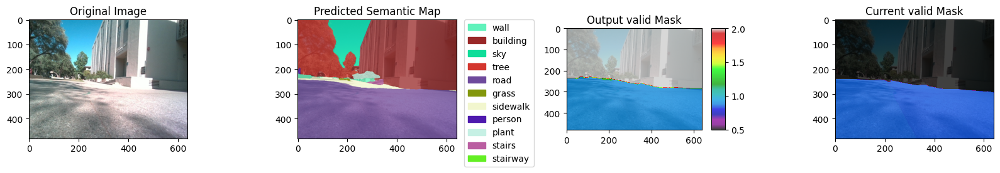

timestamp: 1718144446.907505.npy


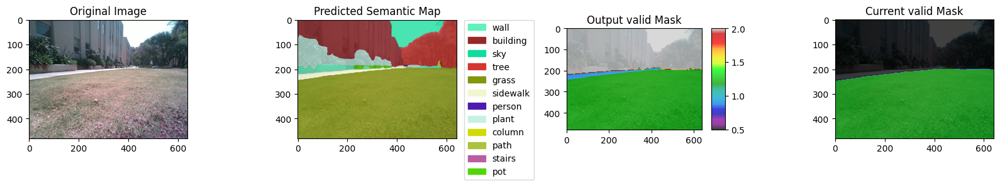

timestamp: 1716768174.101103.npy


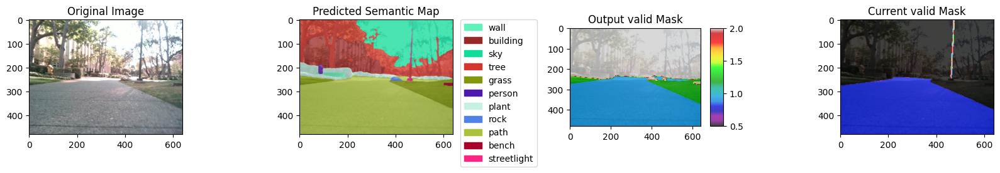

timestamp: 1716767217.710787.npy


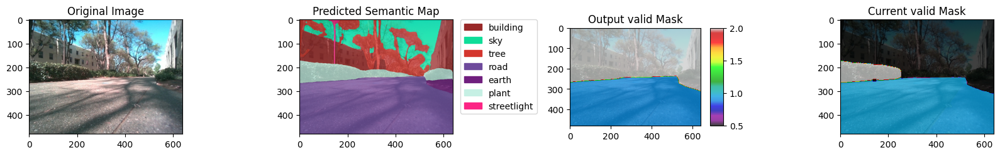

In [8]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
selected_names=[
    "grass",
    "sidewalk",
    "road",
    "floor",
    # "earth",
    "path",
   
]
clear_folder(os.path.join(valid_folder_manually, "mask"))
selected_ids = [int(key) for key, value in id_to_label_name.items() if value in selected_names]
print(selected_ids)
for label_file in label_files:
    labels = np.load(label_file)
    print("timestamp:",os.path.basename(label_file))
    img = Image.open(check_file_path(imaege_folder,os.path.basename(label_file).replace(".npy",".jpg")))
    mask = np.load(check_file_path(valid_folder,"mask",os.path.basename(label_file)))
    output_image = np.ones(labels.shape, dtype=np.float32) * cot_no_traversable
    # mean_cot = np.mean(mask[(mask > 0) & (mask < cot_no_traversable)])
    for i in range(len(selected_ids)):
        output_image[labels == selected_ids[i]] = mean[selected_ids[i]]
    score = np.sum(output_image < cot_no_traversable) / (output_image.shape[0] * output_image.shape[1])
    if score < 0.05:
        print("No traversable area detected", score)
        continue

    fig, ax = plt.subplots(1, 4, figsize=(16, 3))
    ax[0].imshow(img)
    ax[0].set_title('Original Image')
    ax[2].imshow(img)
    ax[2].imshow(output_image, alpha=0.75,cmap='nipy_spectral', vmin=0.5, vmax=cot_no_traversable)
    ax[2].set_title('Output valid Mask')
    ax[3].imshow(img)
    im2 = ax[3].imshow(mask, alpha=0.75,cmap='nipy_spectral', vmin=0.5, vmax=cot_no_traversable)
    ax[3].set_title('Current valid Mask')    
    divider = make_axes_locatable(ax[2])
    cax = divider.append_axes('right', size='10%', pad=0.15)
    fig.colorbar(im2, cax=cax, orientation='vertical')
    plot_predicted_semantic_map(img,labels,ax[1])
    # save as image array
    fig.tight_layout()
    fig.canvas.draw()
    plt.show()

    # save output
    np.save(os.path.join(valid_folder_manually, 'mask', os.path.basename(label_file)), output_image)
    
    # image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')   
    # image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    # break

In [9]:
import shutil
import os
clear_folder(os.path.join(valid_folder_manually, "rgb"))
clear_folder(os.path.join(valid_folder_manually, "depth"))
clear_folder(os.path.join(valid_folder_manually, "segmentation"))

masks = os.listdir(os.path.join(valid_folder_manually, "mask"))
basename_list = []
banned=[
    '1716768596.963062',
    '1718142686.564399',
    '1718144165.251464',
    '1718142733.148760',
    '1718144372.805265',
    '1718144393.227139',
    '1718142731.814675',
    '1716767329.260214',
    '1718141227.442135'
]
for mask in masks:
    basename = filename_to_timestamp(mask)
    if basename in banned:
        print(f"Image {basename} is banned")
        os.remove(os.path.join(valid_folder_manually, "mask", mask))
        continue
    basename_list.append(basename)

# Define the source and destination folders
for listdir in [
    "rgb", 
    "depth",
    "segmentation",
]:
    for e in os.listdir(os.path.join(valid_folder, listdir)):

        basename = filename_to_timestamp(e)
        if basename in basename_list:
            shutil.copy(
                os.path.join(valid_folder, listdir, e),
                os.path.join(valid_folder_manually, listdir, e),
            )
        else:
            print(f"Image {basename} Dir {listdir} not found in the manually labelled folder")
        

# Copy the RGB, depth, confidence, and segmentation images to the destination folder
# shutil.copytree(os.path.join(valid_folder, "rgb"), os.path.join(valid_folder_manually, "rgb"))
# shutil.copytree(os.path.join(valid_folder, "depth"), os.path.join(valid_folder_manually, "depth"))
# # shutil.copytree(os.path.join(valid_folder, "confidence"), os.path.join(valid_folder_manually, "confidence"))
# shutil.copytree(os.path.join(valid_folder, "segmentation"), os.path.join(valid_folder_manually, "segmentation"))


Image 1716768596.963062 is banned
Image 1718142686.564399 is banned
Image 1718144165.251464 is banned
Image 1718142733.148760 is banned
Image 1718144393.227139 is banned
Image 1718144372.805265 is banned
Image 1718142731.814675 is banned
Image 1716767329.260214 is banned
Image 1718141227.442135 is banned
Image 1716768596.963062 Dir rgb not found in the manually labelled folder
Image 1718142733.148760 Dir rgb not found in the manually labelled folder
Image 1718144393.227139 Dir rgb not found in the manually labelled folder
Image 1718142686.564399 Dir rgb not found in the manually labelled folder
Image 1718142731.814675 Dir rgb not found in the manually labelled folder
Image 1718143270.605823 Dir rgb not found in the manually labelled folder
Image 1716767329.260214 Dir rgb not found in the manually labelled folder
Image 1718144165.251464 Dir rgb not found in the manually labelled folder
Image 1718141227.442135 Dir rgb not found in the manually labelled folder
Image 1718144372.805265 Dir 